Так как сейчас в индустрии для таких задач как, детекция и сегментация наиболее актуальны билилиотеки от open-mmlab, решил использовать для этой задачи бибилиотеку mmdetection, с целью ее изучения и применения так же на текущем месте работы. 
Для запуска ноутбука нужно установить бибилиотеку согласно инструкции https://mmdetection.readthedocs.io/en/latest/get_started.html

In [1]:
import os
import tarfile
import urllib.request
import glob
import numpy as np
import xml.etree.ElementTree as ET
from sklearn.model_selection import train_test_split
import torch
import shutil as sh
from IPython.display import display
from torchmetrics.detection.mean_ap import MeanAveragePrecision
import torch
import torchvision.ops.boxes as bops
import json
import mmcv
from mmengine.fileio import dump
from mmengine.utils import track_iter_progress
from mmdet.apis import init_detector, inference_detector
from mmdet.registry import VISUALIZERS
import torch
import numpy as np
from mmengine.structures import InstanceData

Напишем функции для расчета accuracy

In [2]:
def check_predict(uoi_row, assigned_inds, type, found):
    for i in uoi_row.sort(descending=True).indices:
        # проверяем, не был ли сматчен уже этот объект
        if i not in assigned_inds:
            # проверяем, не является ли это пустым перечением если пошли пустые пересения прерываем
            if uoi_row[i] == 0:
                break
            assigned_inds.append(int(i))
            type += 1
            # если условие выполнено прерываем цикл
            found = True
            break
    return assigned_inds, type, found


def get_classification_results(pred, target, uoi_tres=0.3, conf_tres=None, full=True):
    
    TP = 0
    FP = 0
    TN = 0
    FN = 0

    pboxes = pred['boxes']
    plabels = pred['labels']

    if conf_tres:
        pboxes = pboxes[pred['scores'] > conf_tres]
        plabels = plabels[pred['scores'] > conf_tres]

    len_pred = len(pboxes)
    len_tg = len(target['boxes'])
    if len_pred == 0:
        FN += len_tg
        return TP, FP, TN, FN

    assigned_inds = []

    uoi_results = bops.box_iou(pboxes, target['boxes'])
    pred_classes = torch.stack([plabels for _ in range(len_tg)])
    target_classes = torch.stack([target['labels'] for _ in range(len_pred)])
    class_mask = pred_classes.T == target_classes


    for uoi_row, row_class_mask in zip(uoi_results, class_mask):
        if not full:
            if (TP + FP + TN + FN) == len_tg:
                break
        found = False
        
        if sum(row_class_mask) > 0:
            # идем по сценарию Positive
            # проверяем условие на TP
            # если выподняется условие есть пересечение и совпадает класс проходим по списку пересечений, начиная с максимального
            if len(np.where((uoi_row >= uoi_tres) * row_class_mask > 0)[0]) > 0:
                assigned_inds, TP, found = check_predict(uoi_row, assigned_inds, TP, found)
            # если в прошлом цикле выполнены условия, то прерываем итерацию
            if found:
                continue
            # проверяем условие на FP
            if len(np.where((uoi_row < uoi_tres) * row_class_mask > 0)[0]) > 0:
                assigned_inds, FP, found = check_predict(uoi_row, assigned_inds, FP, found)
        # если в прошлом цикле выполнены условия, то прерываем итерацию
        if found:
            continue
        # идем по сценарию Negative
        # проверяем условие на TN
        if len(np.where((uoi_row >= uoi_tres) > 0)[0]) > 0:
            assigned_inds, TN, found = check_predict(uoi_row, assigned_inds, TN, found)
        # Усли ничего не подходит значить FN
        if not found:
            FN += 1

    delta = (TP + FP + TN + FN) - len_tg
    if delta < 0:
        FN -= delta
            
    return TP, FP, TN, FN


def get_accuracy(results, targets, uoi_tres=0.3, conf_tres=None, full=True):
    TP = 0
    FP = 0
    TN = 0
    FN = 0

    for r, t in zip(results, targets):
        tp, fp, tn, fn = get_classification_results(r, t, uoi_tres, conf_tres, full)
        TP += tp
        FP += fp
        TN += tn
        FN += fn

    return (TP + TN) / (TP + TN + FP + FN)

Так как в mmdetection удобнее работать с форматом coco, напишу функцию для перевода аннотаций в этот формат

In [3]:
def convert_xml_to_coco(ann_list, out_file, class_dict):

    categories = []
    for i in class_dict:
        categories.append({'id': class_dict[i], 'name': i})
    annotations = []
    images = []
    obj_count = 0
    for idx, v in enumerate(track_iter_progress(ann_list)):
        tree = ET.parse(v)
        root = tree.getroot()
        filename = root.find('filename').text
        sz = root.find('size')
        width = int(sz.find('width').text)
        height = int(sz.find('height').text)

        images.append(
            dict(id=idx, file_name=filename, height=height, width=width))
        objs = root.findall('object')
        for obj in objs:
            bbx = obj.find('bndbox')
            xmin = int(bbx.find('xmin').text)
            ymin = int(bbx.find('ymin').text)
            xmax = int(bbx.find('xmax').text)
            ymax = int(bbx.find('ymax').text)
            label = class_dict[obj.find('name').text]
            w = xmax - xmin
            h = ymax - ymin
            bbox = [xmin, ymin, w, h]

            data_anno = dict(
                image_id=idx,
                id=obj_count,
                category_id=label,
                bbox=bbox,
                area=w*h,
                segmentation=[],
                iscrowd=0)
            annotations.append(data_anno)
            obj_count += 1

    coco_format_json = dict(
        images=images,
        annotations=annotations,
        categories=categories
        )
    dump(coco_format_json, out_file)

Так же напишу функцию для перевода формата боксов из формата результата модели в формат удобный для печати и метрик

In [5]:
def xywh_to_xyxy(box):
    x0, y0, w, h = box
    return (x0, y0, x0 + w, y0 + h)

In [5]:
# Загрузка датасета
if not os.path.exists("VOCdevkit"):
    if not os.path.exists("VOC.tar"):
        urllib.request.urlretrieve(
            "https://pjreddie.com/media/files/VOCtrainval_11-May-2012.tar", "VOC.tar"
        )
    with tarfile.open("VOC.tar") as tar:
        tar.extractall()

In [6]:
# Разделим данные на train и test
os.mkdir('data/voc_coco')
os.mkdir('data/voc_coco/train')
os.mkdir('data/voc_coco/val')

im_list = glob.glob('../VOCdevkit/VOC2012/JPEGImages/2010*.jpg')

x_train, x_test = train_test_split(im_list, test_size=0.2, random_state=42)

for file in x_train:
    sh.copyfile(file, f"data/voc_coco/train/{file.split('/')[-1]}")

for file in x_test:
    sh.copyfile(file, f"data/voc_coco/val/{file.split('/')[-1]}")

ann_train = [x.replace('JPEGImages', 'Annotations').replace('jpg', 'xml') for x in x_train]
ann_test = [x.replace('JPEGImages', 'Annotations').replace('jpg', 'xml') for x in x_test]

In [7]:
#  Переведем аннотации в формат coco
path = '../VOCdevkit/VOC2012/Annotations/'
ann_list = glob.glob(path + '/2010*.xml')

class_list = set()
for file in ann_list:
    tree = ET.parse(file)
    root = tree.getroot()
    objs = root.findall('object')
    for obj in objs:
        class_list.add(obj.find('name').text)
        
class_dict = dict()
for i, item in enumerate(class_list):
    class_dict[item] = i


convert_xml_to_coco(ann_train, './data/voc_coco/train.json', class_dict)
convert_xml_to_coco(ann_test, './data/voc_coco/test.json', class_dict)

In [11]:
# Загрузим валидационные данные
with open('./data/voc_coco/val.json', 'r') as f:
    data = json.load(f)

ims = os.listdir('./data/voc_coco/val/')
ims = ['./data/voc_coco/val/'+i for i in ims]

len(ims)

701

# Faster-RCNN

In [28]:
# Воспользуемся штатным загрузчиком mmlab для загрузки весов FasterRCNN
!mim download mmdet --config faster-rcnn_r50_fpn_mstrain_3x_coco --dest checkpoints

Для обучения модели, я передел стандартный конфигурационный файл для загрузки нашего датасета, использования скачанных весов проедобученной модели, так же добавил early stopping и аугментации.

In [9]:
# Обучим модель встренноую тулзу от mmdetection
!python tools/train.py configs/faster_rcnn/faster-rcnn_custom2.py

In [3]:
# Лучший результат модель показала на 9-й эпохе, посмотрим результаты
config_file = './work_dirs/faster-rcnn_custom2/faster-rcnn_custom2.py'
checkpoint_file = './work_dirs/faster-rcnn_custom2/epoch_9.pth'
model = init_detector(config_file, checkpoint_file, device='cuda:0')

Loads checkpoint by local backend from path: ./work_dirs/faster-rcnn_custom2/epoch_9.pth


In [115]:
# Получим резльтаты на валидации
results = inference_detector(model, ims)

In [116]:
# Подготовим результаты для визуализации, возьмем только 50 примеров из 701
for i in range(len(results[:50])):
    im_path = results[i].img_path.split('/')[-1]
    for im in data['images']:
        if im['file_name'] == im_path:
            id = im['id']
            break
    boxes = []
    labels = []
    for ann in data['annotations']:
        if ann['image_id'] == id:
            boxes.append(xywh_to_xyxy(ann['bbox']))
            labels.append(ann['category_id'])
    gt_instances = InstanceData()
    gt_instances.bboxes = torch.tensor(boxes)
    gt_instances.labels = torch.tensor(labels)
    results[i].gt_instances = gt_instances

/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(
/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/visualization/visualizer.py:757: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/visualization/visualizer.py:828: UserWarning: Warning: The polygon is out of bounds, the drawn polygon may not be in the image
  warnings.warn(


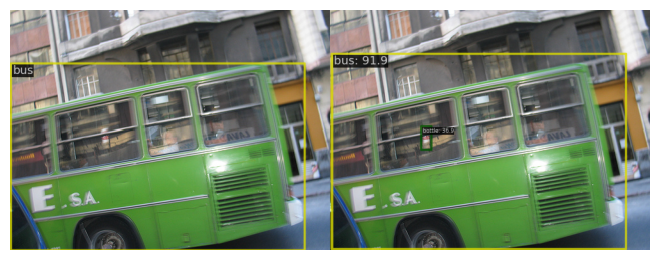

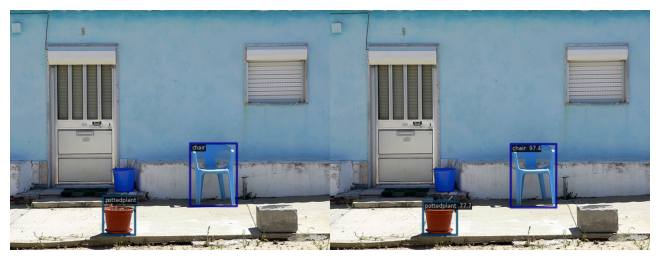

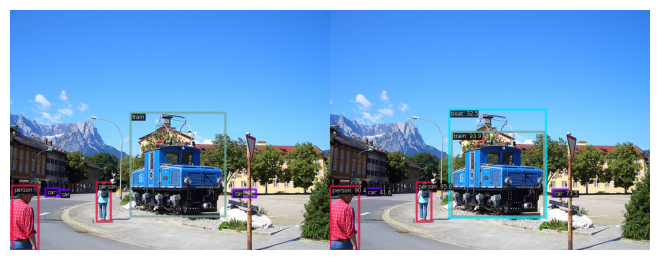

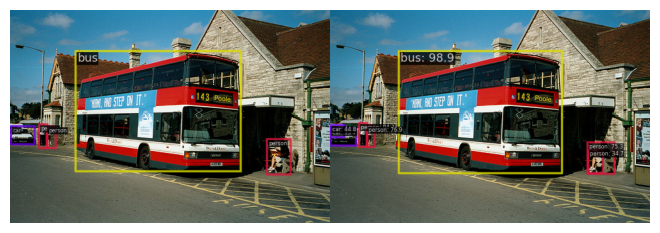

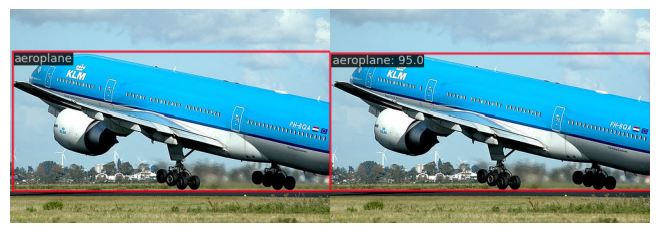

...

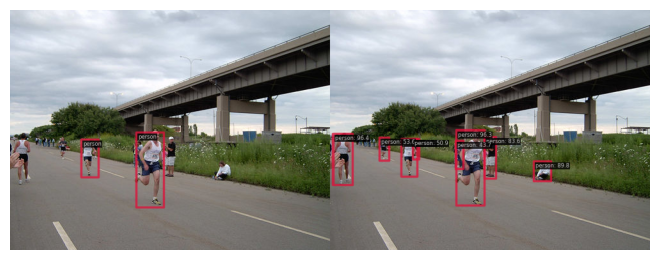

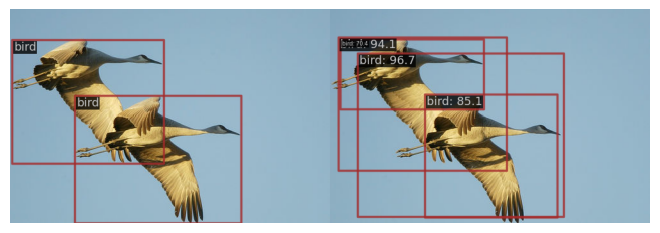

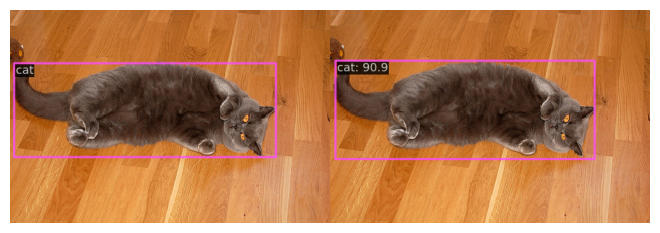

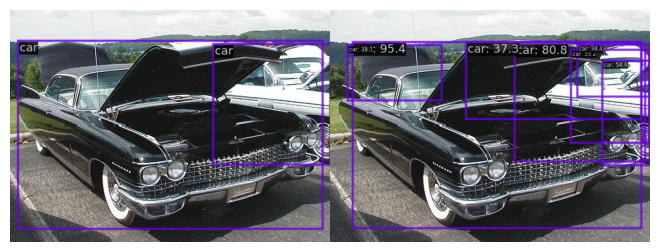

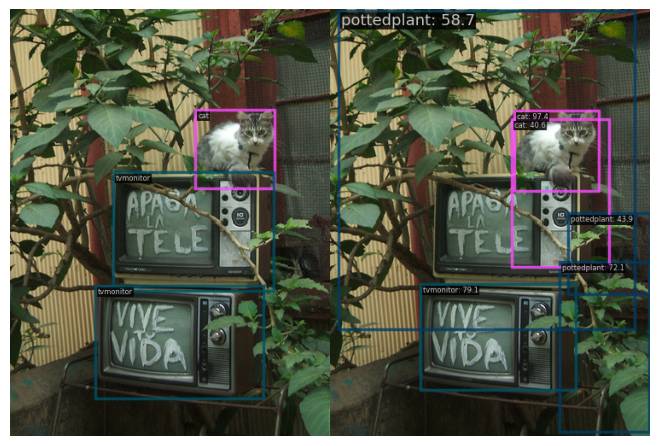

In [117]:
# Используем встроенный визуализатор для просмотра результатов, слева ground truth, справа предикт
for i in results[:50]:
    visualizer = VISUALIZERS.build(model.cfg.visualizer)
    visualizer.dataset_meta = model.dataset_meta
    img = mmcv.imread(i.img_path)
    img = mmcv.imconvert(img, 'bgr', 'rgb')
    visualizer.add_datasample(
        i.img_path.split('/')[-1],
        img,
        data_sample=i,
        draw_gt=True,
        draw_pred=True,
        show=True)
    display(visualizer.show())

Как видим результаты не плохие. Так же можем заметить низкое качество разметки - когда на изображении не все классы размечены, не смотря на то что довольно хорошо видны. При этом модель часть этих неразмеченных классов определила. Для повышения качества, в данном случае, можно начать с исправления разметки.

In [124]:
# Подоготовим данные для метрик
preds = []
targets = []
for r in results:
    res = r.pred_instances.cpu().to_dict()
    res['boxes'] = res['bboxes']
    del res['bboxes']
    preds.append(res)
    for img in data['images']:
        if img['file_name'] == r.img_path.split('/')[-1]:
            labels = []
            bboxes = []
            for a in data['annotations']:
                if a['image_id'] == img['id']:
                    labels.append(a['category_id'])
                    x, y, w, h = a['bbox']
                    bbox = [x, y, x+w, y+h]
                    bboxes.append(bbox)
            ann = {'labels': torch.tensor(labels),
                'boxes': torch.tensor(bboxes)}
            targets.append(ann)

In [131]:
# Посчитаем метрики coco
metric = MeanAveragePrecision()
metric.update(preds, targets)
fastRCNNmetrics = metric.compute()

In [132]:
fastRCNNmetrics

{'map': tensor(0.5234),
 'map_50': tensor(0.7445),
 'map_75': tensor(0.5942),
 'map_small': tensor(0.3121),
 'map_medium': tensor(0.4542),
 'map_large': tensor(0.5888),
 'mar_1': tensor(0.4879),
 'mar_10': tensor(0.6694),
 'mar_100': tensor(0.6714),
 'mar_small': tensor(0.4040),
 'mar_medium': tensor(0.5976),
 'mar_large': tensor(0.7269),
 'map_per_class': tensor(-1.),
 'mar_100_per_class': tensor(-1.),
 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19], dtype=torch.int32)}

Как видим по сложной метрике map[0.5..0.95](первая строчка) результат не выдающийся, но по map_50, результат хороший. Посчитаем accuracy, используя написанную выше функцию. Так же подберем порог uoi и confidence, при котором accuracy будет выше необходимого в задании.

In [130]:
get_accuracy(preds, targets, uoi_tres=0.4, conf_tres=0.2, full=False)

0.8534370946822308

# YOLOX

Так как в данной библиотеке есть предобученные модели yolo3 и yoloX, а yolo5 нет, решил использовать в задании yoloX

In [1]:
# Воспользуемся штатным загрузчиком mmlab для загрузки весов YoloX
!mim download mmdet --config yolox_s_8x8_300e_coco --dest checkpoints

Для обучения модели, я передел стандартный конфигурационный файл для загрузки нашего датасета, использования скачанных весов проедобученной модели, так же добавил early stopping и аугментации.

In [8]:
# Обучим модель встренноую тулзу от mmdetection
!python tools/train.py configs/yolox/yolox_s_8x8b8_300e_coco_VOC2.py

In [8]:
# Лучший результат модель показала на 200-й эпохе, посмотрим результаты
config_file = './work_dirs/yolox_s_8x8b8_300e_coco_VOC2/yolox_s_8x8b8_300e_coco_VOC2.py'
checkpoint_file = './work_dirs/yolox_s_8x8b8_300e_coco_VOC2/epoch_200.pth'
model = init_detector(config_file, checkpoint_file, device='cuda:0')

Loads checkpoint by local backend from path: ./work_dirs/yolox_s_8x8b8_300e_coco_VOC2/epoch_200.pth


In [12]:
# Получим резльтаты на валидации
results = inference_detector(model, ims)

/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [13]:
# Подготовим результаты для визуализации, возьмем только 50 примеров из 701
for i in range(len(results[:50])):
    im_path = results[i].img_path.split('/')[-1]
    for im in data['images']:
        if im['file_name'] == im_path:
            id = im['id']
            break
    boxes = []
    labels = []
    for ann in data['annotations']:
        if ann['image_id'] == id:
            boxes.append(xywh_to_xyxy(ann['bbox']))
            labels.append(ann['category_id'])
    gt_instances = InstanceData()
    gt_instances.bboxes = torch.tensor(boxes)
    gt_instances.labels = torch.tensor(labels)
    results[i].gt_instances = gt_instances

11/12 16:40:35 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.


/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/visualization/visualizer.py:757: UserWarning: Warning: The bbox is out of bounds, the drawn bbox may not be in the image
  warnings.warn(
/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/visualization/visualizer.py:828: UserWarning: Warning: The polygon is out of bounds, the drawn polygon may not be in the image
  warnings.warn(


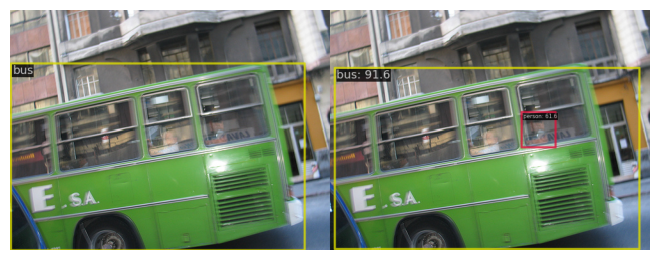

/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/utils/manager.py:113: UserWarning: <class 'mmdet.visualization.local_visualizer.DetLocalVisualizer'> instance named of visualizer has been created, the method `get_instance` should not accept any other arguments
  warnings.warn(


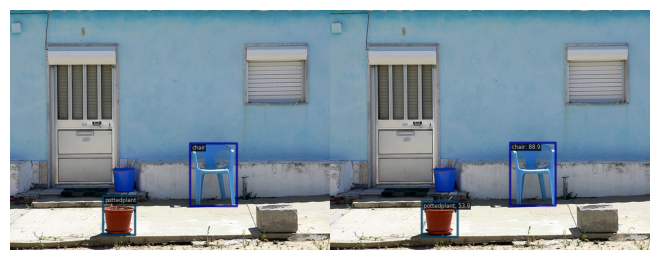

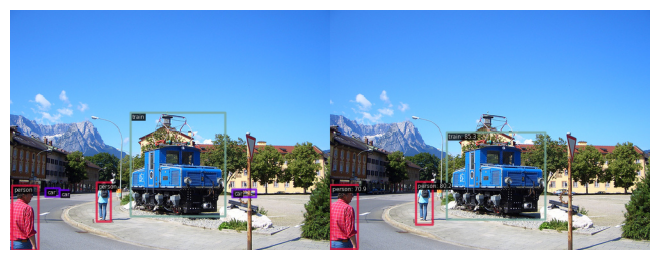

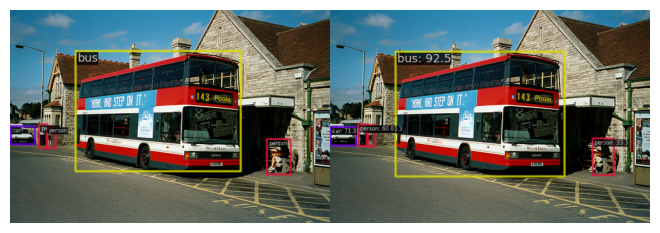

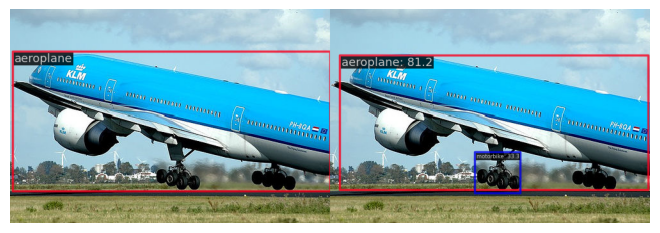

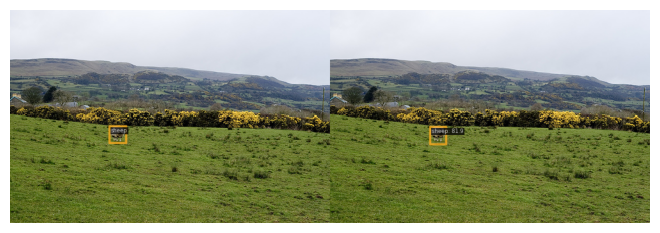

...

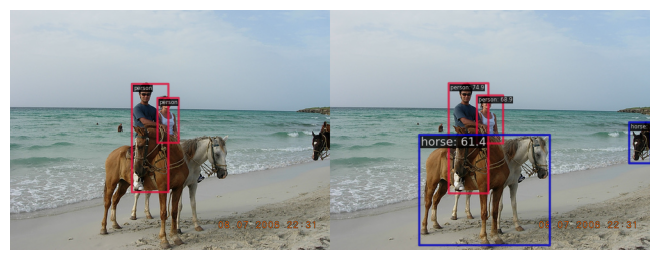

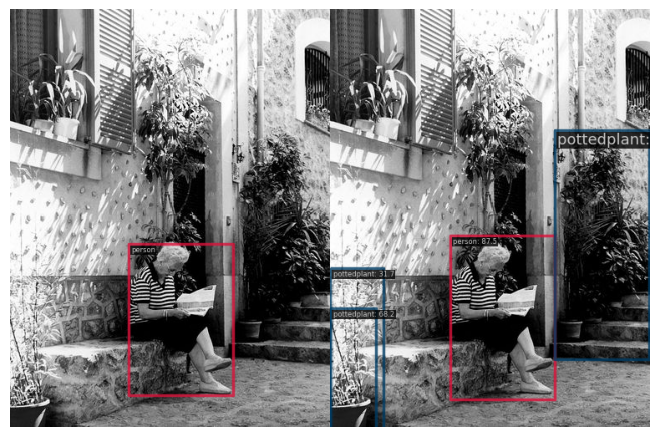

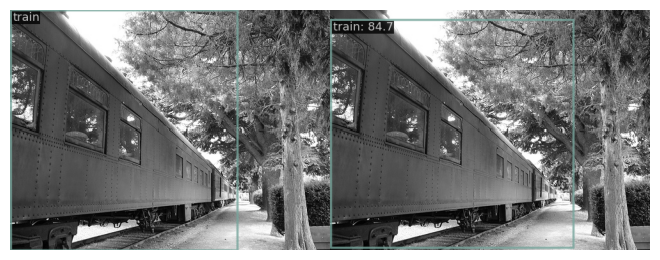

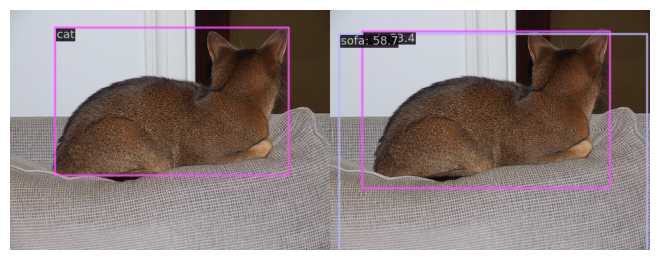

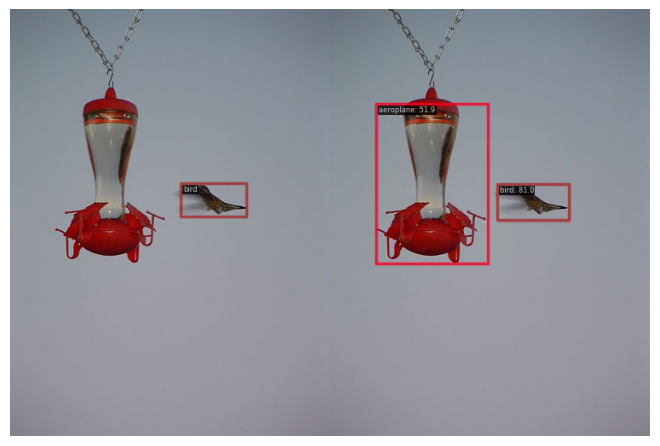

/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/mmengine/visualization/visualizer.py:505: UserWarning: Warning: The text is out of bounds, the drawn text may not be in the image
  warnings.warn(


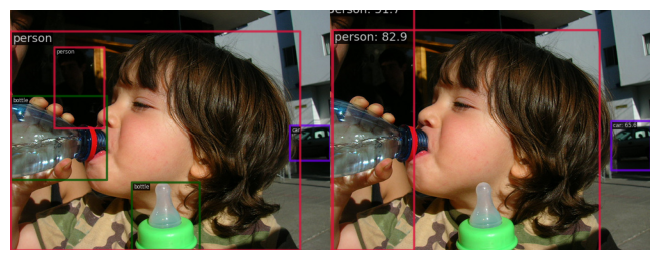

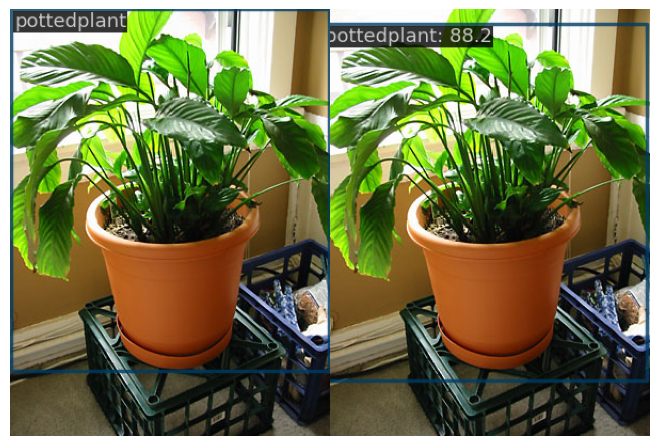

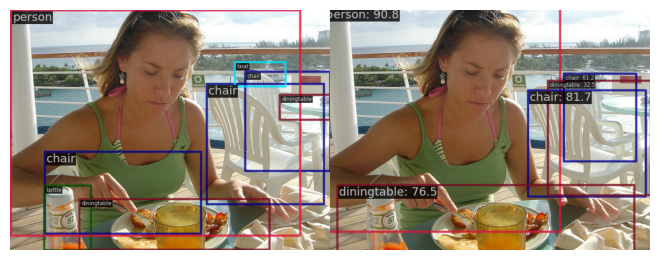

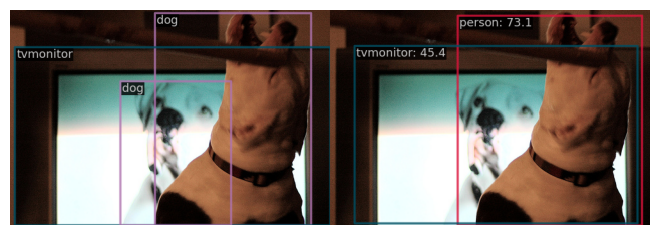

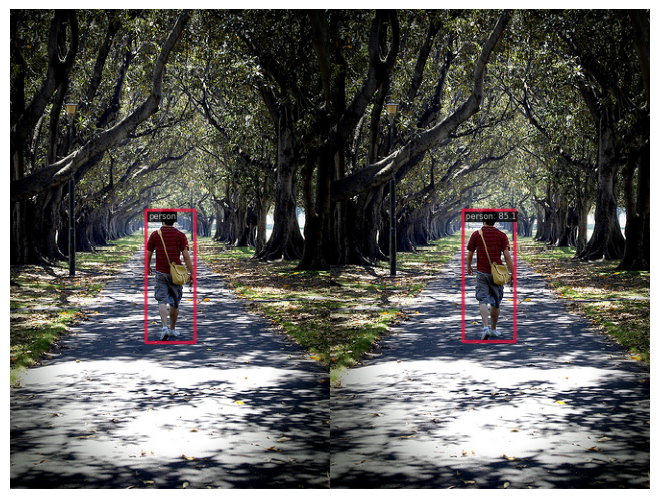

...

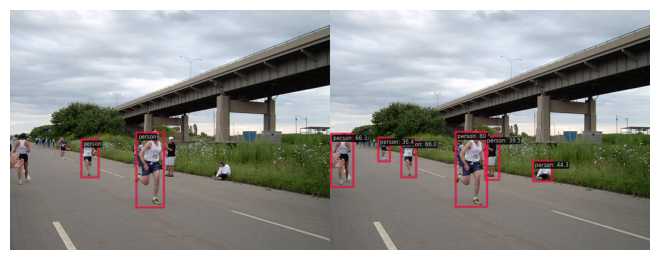

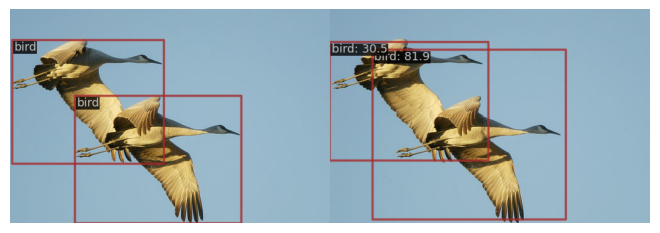

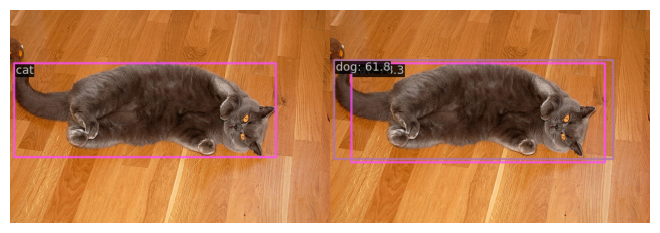

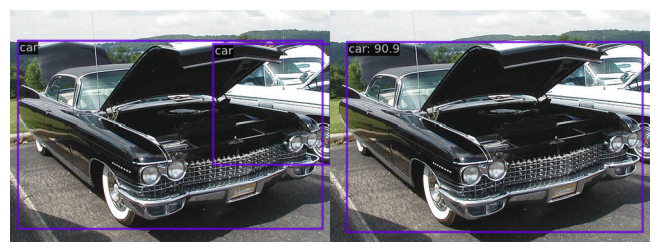

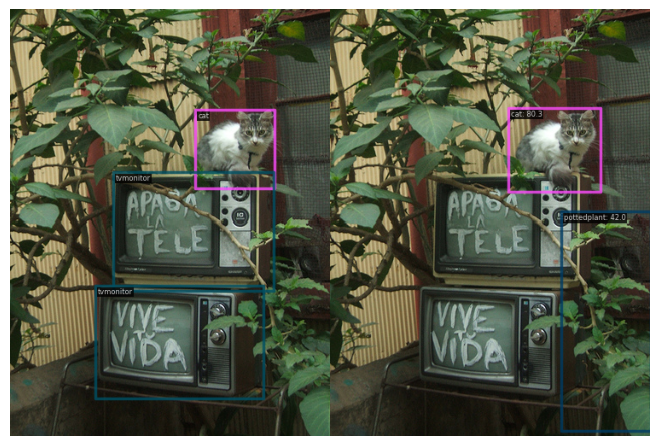

In [14]:
# Используем встроенный визуализатор для просмотра результатов, слева ground truth, справа предикт
for i in results[:50]:
    visualizer = VISUALIZERS.build(model.cfg.visualizer)
    visualizer.dataset_meta = model.dataset_meta
    img = mmcv.imread(i.img_path)
    img = mmcv.imconvert(img, 'bgr', 'rgb')
    visualizer.add_datasample(
        i.img_path.split('/')[-1],
        img,
        data_sample=i,
        draw_gt=True,
        draw_pred=True,
        show=True)
    display(visualizer.show())

Как видим результаты так же не плохие.

In [15]:
# Подоготовим данные для метрик
preds = []
targets = []
for r in results:
    res = r.pred_instances.cpu().to_dict()
    res['boxes'] = res['bboxes']
    del res['bboxes']
    preds.append(res)
    for img in data['images']:
        if img['file_name'] == r.img_path.split('/')[-1]:
            labels = []
            bboxes = []
            for a in data['annotations']:
                if a['image_id'] == img['id']:
                    labels.append(a['category_id'])
                    x, y, w, h = a['bbox']
                    bbox = [x, y, x+w, y+h]
                    bboxes.append(bbox)
            ann = {'labels': torch.tensor(labels),
                'boxes': torch.tensor(bboxes)}
            targets.append(ann)

In [17]:
# Посчитаем метрики coco
metric = MeanAveragePrecision()
metric.update(preds, targets)
YoloXmetrics = metric.compute()

/home/eugene/anaconda3/envs/openmmlab/lib/python3.9/site-packages/torchmetrics/utilities/prints.py:43: UserWarning: Encountered more than 100 detections in a single image. This means that certain detections with the lowest scores will be ignored, that may have an undesirable impact on performance. Please consider adjusting the `max_detection_threshold` to suit your use case. To disable this warning, set attribute class `warn_on_many_detections=False`, after initializing the metric.
  warnings.warn(*args, **kwargs)  # noqa: B028


In [18]:
YoloXmetrics

{'map': tensor(0.5011),
 'map_50': tensor(0.7450),
 'map_75': tensor(0.5513),
 'map_small': tensor(0.2090),
 'map_medium': tensor(0.3806),
 'map_large': tensor(0.5792),
 'mar_1': tensor(0.4573),
 'mar_10': tensor(0.6238),
 'mar_100': tensor(0.6286),
 'mar_small': tensor(0.3636),
 'mar_medium': tensor(0.5384),
 'mar_large': tensor(0.6920),
 'map_per_class': tensor(-1.),
 'mar_100_per_class': tensor(-1.),
 'classes': tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
         18, 19], dtype=torch.int32)}

Как видим по сложной метрике map[0.5..0.95](первая строчка) результат несколько ниже, чем у FasterRCNN. Посчитаем accuracy, используя написанную выше функцию. Так же подберем порог uoi и confidence, при котором accuracy будет выше необходимого в задании.

In [24]:
get_accuracy(preds, targets, uoi_tres=0.4, conf_tres=0.2, full=False)

0.8274967574578469

Как видим, при тех же порогах, модель показывает хуже результат

In [25]:
get_accuracy(preds, targets, uoi_tres=0.2, conf_tres=0.2, full=False)

0.8566796368352788

По итогам работы видим, не смотря на то, что yoloX гораздо более продвинутая модель, однако все еще показывает результат несколько хуже, чем гораздо более старая но двухстадийная модель детекции FasterRCNN